# LERN historic drifter database: cleaning


In [1]:
import os
from glob import glob

import numpy as np
import pandas as pd

%matplotlib inline
import matplotlib.pyplot as plt
import hvplot.pandas  # noqa

#
import pynsitu as pin
from pynsitu.maps import crs
import taos.sensors as se

/Users/aponte/.miniconda3/envs/pynsitu/lib/python3.10/site-packages/pyTMD/tools.py:55: UserWarning: ipyleaflet not available
  warnings.warn("ipyleaflet not available")
/Users/aponte/.miniconda3/envs/pynsitu/lib/python3.10/site-packages/pyTMD/tools.py:56: UserWarning: Some functions will throw an exception if called
  warnings.warn("Some functions will throw an exception if called")
/Users/aponte/.miniconda3/envs/pynsitu/lib/python3.10/site-packages/traitlets/traitlets.py:1016: DeprecationWarning: Widget._active_widgets is deprecated.
  value = getattr(cls, name)
/Users/aponte/.miniconda3/envs/pynsitu/lib/python3.10/site-packages/traitlets/traitlets.py:1016: DeprecationWarning: Widget._widget_types is deprecated.
  value = getattr(cls, name)
/Users/aponte/.miniconda3/envs/pynsitu/lib/python3.10/site-packages/traitlets/traitlets.py:1016: DeprecationWarning: Widget.widget_types is deprecated.
  value = getattr(cls, name)
/Users/aponte/.miniconda3/envs/pynsitu/lib/python3.10/site-packages

In [2]:
## taos
root_dir = "/Users/aponte/Current_Projects/taos/campagnes/drifters_lern/"

# lern_
#campaign="taos0_drifters0"
#yaml = f"drifters0/{campaign}.yaml"

# taos0-drifters1
yaml = "lern_drifters.yaml"

cp = pin.Campaign(os.path.join(root_dir,yaml))

# plot all deployments
for label, deployment, platform, sensor, meta in cp.get_all_deployments():
    print(label, platform, sensor, deployment)

d0 LERN-I-0001 None d0 / start 2012-10-09 14:00:00 / end 2012-10-16 09:50:10
d1 LERN-I-0001 None d1 / start 2013-02-08 08:00:00 / end 2013-02-16 14:30:10
d2 LERN-I-0001 None d2 / start 2013-03-28 09:00:00 / end 2013-04-03 20:30:00
r0 LERN-I-0001 None r0 / start 2016-09-27 11:00:00 / end 2016-10-07 12:40:30
r1 LERN-I-0001 None r1 / start 2017-02-01 11:30:00 / end 2017-02-06 15:31:00
r2 LERN-I-0001 None r2 / start 2017-04-20 12:20:00 / end 2017-04-24 11:40:10
r3 LERN-I-0001 None r3 / start 2017-06-28 12:20:00 / end 2017-07-04 06:40:00
r4 LERN-I-0001 None r4 / start 2018-01-30 10:20:00 / end 2018-02-28 09:40:30
d0 LERN-I-0002 None d0 / start 2013-02-08 08:20:00 / end 2013-02-13 11:10:15
d1 LERN-I-0002 None d1 / start 2012-10-09 14:10:00 / end 2012-10-16 08:40:10
d2 LERN-I-0002 None d2 / start 2013-03-28 09:10:00 / end 2013-04-02 08:40:00
r0 LERN-I-0002 None r0 / start 2017-02-01 11:40:00 / end 2017-02-06 16:10:10
r1 LERN-I-0002 None r1 / start 2017-04-20 13:00:00 / end 2017-04-24 10:30:10

---

## drifters

Required to install `openpyxl` and : 

```
pip install openpyxl
pip install xlrd
```




In [3]:
def read_lern_drifter(file):
    """ read one file """
    df = pd.read_excel(file, parse_dates=[1])
    df = (df
          .rename(columns=dict(DeviceName="id", DeviceDateTime="time", 
                               Latitude="latitude", Longitude="longitude",
                               Temperature0cm="temperature", SubmergedBoolean="submerged",
                              ))
          #.set_index("time")
          #.sort_index()
         )

    for c in ["longitude", "latitude"]:
        df[c] = df[c].apply(parse_coords)
    
    return df

def parse_coords(x):
    """ assumes """
    if isinstance(x, float):
        return x
    xs = x.replace("°", " ").replace("'"," ").split()
    s = 1
    if xs[2]=="W" or xs[2]=="S":
        s = -1
    x = s*( float(xs[0]) + float(xs[1])/60)
    return x

def read_lern_drifter_all(data_path):
    """ read multiple files """
    files = sorted(glob(data_path))
    df = pd.concat([read_lern_drifter(f).reset_index() for f in files])
    df = df.drop_duplicates(["time", "id"])
    return df.set_index("id")

In [4]:
df0 = read_lern_drifter_all(os.path.join(cp["path_raw"], "DILEMES/*.xls*"))
df0["project"] = "DILEMES"
df1 = read_lern_drifter_all(os.path.join(cp["path_raw"], "RESUME/*.xls*"))
df1["project"] = "RESUME"

df = pd.concat([df0, df1])

Test if ids in data file and yaml file are identical

In [5]:
# print serial numbers (CommIds) to fill yaml file
df.loc[~df.index.duplicated(keep="first")]["CommId"]

id
LERN-I-0001     300234011883260
LERN-I-0002     300234011885260
LERN-I-0003     300234011886260
LERN-I-0004     300234011887260
LERN-I-0005     300234011888260
LERN-I-0006     300234011889260
LERN-MS-0008    300234065166490
LERN-MS-0009    300234065167490
Name: CommId, dtype: int64

In [6]:
ids = sorted(list(df.index.unique()))
ids_map = {p: cp[p]["serial_number"] for p in cp if  "LERN" in p}
#
#ids_yaml = sorted(set([sn for _, sn in ids_map.items()]))
ids_yaml = sorted(set(ids_map))
ids_imap = {v: k for k, v in ids_map.items()}

print("drifter id's in data file:")
print(ids)
print("drifter id's in yaml file:")
print(ids_yaml)

flag = set(ids).issuperset(ids_yaml)
if flag:
    print("Data file and campaign yaml file agree upon drifter ids")
else:
    assert False, "Data file and campaign yaml file do not agree upon drifter ids"

drifter id's in data file:
['LERN-I-0001', 'LERN-I-0002', 'LERN-I-0003', 'LERN-I-0004', 'LERN-I-0005', 'LERN-I-0006', 'LERN-MS-0008', 'LERN-MS-0009']
drifter id's in yaml file:
['LERN-I-0001', 'LERN-I-0002', 'LERN-I-0003', 'LERN-I-0004', 'LERN-I-0005', 'LERN-I-0006', 'LERN-MS-0008', 'LERN-MS-0009']
Data file and campaign yaml file agree upon drifter ids



### compute and show typical time intervals

This is to decide on a reasonable target timeline.
A 1 minutes sampling rate seems reasonable after interpolation.

Percentage of time invervals between 4 and 6 minutes: 0%


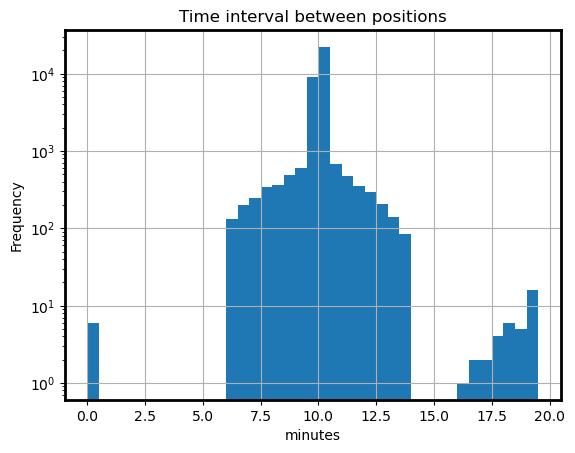

In [7]:
dt = (
    df.groupby(df.index)
    .apply(lambda df: df.sort_values("time")["time"].diff() / pd.Timedelta("1m"))
    .droplevel(0)
)

# drop small time intervals
# df = df.loc[df.dt>3]

fig, ax = plt.subplots(1, 1)
dt.plot.hist(bins=np.arange(0, 20, 0.5))
ax.set_yscale("log")
ax.grid()
ax.set_title("Time interval between positions")
ax.set_xlabel("minutes")

_frac = dt.loc[np.abs(dt - 5) < 1].size / dt.size
print(f"Percentage of time invervals between 4 and 6 minutes: {_frac*100:.0f}%")

---
## manually adjust deployment times first

This is performed for each drifter individually

In [8]:
#p, d = "drifter5", "d0"
#p, d = "drifter5", "d1"
p, d = "LERN-I-0001", "d1" # d0, d1, d2, r0, r1, r2, r3, r4
#p, d = "LERN-I-0002", "r2" # d0, d1, d2, r0, r1, r2
#p, d = "LERN-I-0003", "r0" # d0, d1, d2, 
#p, d = "LERN-I-0004", "d1" # d0, d1
#p, d = "LERN-I-0005", "d0" # d0
#p, d = "LERN-I-0006", "r2" # d0, d1, d2, d3, r0, r1, r2, r3
#p, d = "LERN-MS-0008", "d0" # d0
#p, d = "LERN-MS-0009", "d1" # d0, d1

_id = ids_map[p]
print(f"Drifter id: {_id}")

_df = df.loc[df["CommId"] == _id].set_index("time").sort_index()
_df.geo.compute_velocities(inplace=True)
_df.geo.plot_bokeh(deployments=cp[p][d], velocity=True, acceleration=True)

Drifter id: 300234011883260


Loading BokehJS ...

In [9]:
# all trajectories, may mix deployments
#phv, coords = _df.geo.plot_on_map(s=10, c="velocity", clim=(0,1), cmap="magma")
#phv

---

## process one trajectory for illustration

### Show raw speed distribution (for despiking purposes)

In [10]:
df0 = (df.loc[df["CommId"] == _id]
       .set_index("time")
       .sort_index()
      )

# trim before computing speed
df0 = df0.ts.trim(cp[p][d])

# compute speed
df0 = df0.geo.compute_velocities(keep_dt=True)
df0 = df0.geo.compute_accelerations()

# plot
df0.geo.plot_bokeh(velocity=True, acceleration=True)

Loading BokehJS ...

In [11]:
p, d

('LERN-I-0001', 'd1')

In [12]:
phv, coords = df0.geo.plot_on_map(s=10, c="velocity", clim=(0,1), cmap="magma")
phv

:Overlay
   .Tiles.I  :Tiles   [x,y]
   .Points.I :Points   [longitude,latitude]   (velocity,time)

### **step 1**: drops positions that are too close (less than 1 minute apart)

Pairs of points may be seperated by less than a minute.

Should we drop early or late data point?
We choose to drop the early point which seems to be associated with an earlier point

**Nearby positions allways seem to follow an extended time period without positions - verify !!**


In [13]:
dt_nearby_threshold = 2 # in minutes

df_bad = df0.loc[df0["dt"]<60*dt_nearby_threshold]
n_bad = df_bad.index.size
n_bad

0

In [14]:
def plot_target_time(df, t, dt=None):
    if dt is None:
        dt = pd.Timedelta("20T")
    elif isinstance(dt, str):
        dt = pd.Timedelta(dt)

    df = df.loc[ (df.index>t-dt) & (df.index<t+dt)].copy()
    df.loc[:,"x"] = df.loc[:,"x"]-df["x"].mean()
    df.loc[:,"y"] = df.loc[:,"y"]-df["y"].mean()

    tm = df.loc[ df.index<t ].index[-1]
    
    fig, axes = plt.subplots(1,3, figsize=(10,3))
    #
    ax = axes[0]
    ax.plot(df["x"], df["y"], "k")
    ms = 50
    ax.scatter(df.loc[tm, "x"], df.loc[tm, "y"], 2*ms, marker="p", color="orange")
    ax.scatter(df.loc[t, "x"], df.loc[t, "y"], 2*ms, marker="p", color="red")
    ax.scatter(df["x"], df["y"], ms, marker="x")
    ax.scatter(df.iloc[0]["x"], df.iloc[0]["y"], 2*ms, marker="o", color="cadetblue")
    ax.grid()
    #
    ax = axes[1]
    kwargs = dict(ax=ax, ls="-", marker="+")
    ax.scatter(df.index[0], df.iloc[0]["velocity"], 2*ms, marker="o", color="cadetblue")
    df["velocity_east"].plot(**kwargs)
    df["velocity_north"].plot(**kwargs)
    df["velocity"].plot(**kwargs, color="k")
    ax.scatter(tm, df.loc[tm, "velocity"], 2*ms, marker="p", color="orange")
    ax.scatter(t, df.loc[t, "velocity"], 2*ms, marker="p", color="red")
    ax.grid()
    #
    ax = axes[2]
    kwargs = dict(ax=ax, ls="-", marker="+")
    ax.scatter(df.index[0], df.iloc[0]["acceleration"], 2*ms, marker="o", color="cadetblue")
    df["acceleration_east"].plot(**kwargs)
    df["acceleration_north"].plot(**kwargs)
    df["acceleration"].plot(**kwargs, color="k")
    ax.scatter(tm, df.loc[tm, "acceleration"], 2*ms, marker="p", color="orange")
    ax.scatter(t, df.loc[t, "acceleration"], 2*ms, marker="p", color="red")
    ax.grid()


In [15]:
for t in df_bad.index:
    plot_target_time(df0, t)

In [16]:
def drop_nearby_times(df, dt_threshold):
    """ Find pairs of neighboring times and drop the first time from dataframe
    
    Parameters
    ----------
    df: pd.DataFrame
    dt_thresdhold: int, float
        Threshold defining nearby times in minutes
    Returns
    -------
    df: pd.DataFrame
        Cleaned dataframe
    """
    
    # find nearby times
    df_bad = df.loc[df["dt"]<60*dt_threshold]
    print(f"{df_bad.index.size} neighboring times found ({dt_threshold} minutes threshold)")
    
    # drop
    df = df.drop([df.loc[ df.index<t ].index[-1] for t in df_bad.index])
    
    # update velocity
    df = df.geo.compute_velocities(keep_dt=True)
    df = df.geo.compute_accelerations()

    return df

In [17]:
df1 = drop_nearby_times(df0, dt_nearby_threshold)

0 neighboring times found (2 minutes threshold)


### **step 2** : manual editing of anomalous intervals

We are generous with time invervals to smooth errors as much as possible

In [18]:
M = dict()
M["LERN-I-0001"] = [slice("2013/03/28 20:00:00", "2013/03/28 21:10:00")]
M["LERN-I-0002"] = [slice("2013/02/10 06:40:00", "2013/02/10 07:50:10")]
M["LERN-I-0004"] = [slice("2013/02/11 21:50:00", "2013/02/11 23:00:00"),
                    slice("2013/03/30 17:10:00", "2013/03/30 18:11:00"),
                   ]
M["LERN-I-0005"] = [slice("2013/02/10 21:30:00", "2013/02/10 22:10:20")]
M["LERN-I-0006"] = [slice("2013/04/11 14:50:00", "2013/04/11 16:10:00"),
                    slice("2013/09/28 01:30:00", "2013/09/28 03:10:00"),
                    slice("2017/04/26 14:30:00", "2017/04/26 16:10:00"),
                   ]


In [19]:
def manual_edit(df, M):
    for m in M:
        df = df.loc[ (df.index<m.start) | (df.index>m.stop) ]
    return df

if p in M:
    df2 = manual_edit(df1, M[p])
else:
    df2 = df1

### **step 3**: despike isolated anomalous values

This is based on anomalous acceleration values combined with acceleration adequate sign reversal (see `despike_isolated` doc).

0 m/s to 1 m/s over 3h is approx 1e-4, we are conservative and choose a looser threshold

In [20]:
acceleration_threshold = 1e-3

df3 = pin.drifters.despike_isolated(df2, acceleration_threshold)
df3.geo.compute_velocities(inplace=True)
df3.geo.compute_accelerations(inplace=True)


# plot
df3.geo.plot_bokeh(velocity=True, acceleration=True)

2 single spikes dropped out of 2 potential ones (acceleration threshold)


Loading BokehJS ...

### **step 4**: smooth/interpolate time series

How can we objectively choose parameter values: `position_error`, `acceleration_amplitude`, `acceleration_T` ?

Could look at the sensitivity of histograms to these parameters or more global metrics (std)

In [21]:
# remaining peaks are presumably jumps in positions and should be smoothed out
# interpolate along the way

position_error = 100
acceleration_amplitude = 4*1e-4 # m/s^2
acceleration_T = 3600*3 # less effect than acceleration_amplitude in smoothing acceleration
dt = "2T"

t_target = pd.date_range(
    cp[p][d].start.time.floor(dt),
    cp[p][d].end.time.ceil(dt),
    freq=dt,
)

df4 = pin.drifters.resample_smooth(
    df3, t_target, position_error, acceleration_amplitude, acceleration_T,
)
# velocity/acceleration are updated by default

Chunking dataframe into 2 days chunks


In [26]:
kwargs = dict(x="x", y="y", hover_cols=['time'])

_df = df4.reset_index()
_df0 = df0.reset_index()

(_df.hvplot(**kwargs, color="k", line_width=2)
*_df.hvplot.scatter(**kwargs, s=30, c="velocity").opts(clim=(0,1), cmap="magma")
*_df0.hvplot.scatter(**kwargs, s=10, c="cadetblue")
).opts(show_grid=True)

:Overlay
   .Curve.I    :Curve   [x]   (y,time)
   .Scatter.I  :Scatter   [x]   (y,velocity,time)
   .Scatter.II :Scatter   [x]   (y,time)

In [27]:
# 'CartoLight', 'EsriNatGeo', 'EsriTerrain'
#kwargs = dict(x="longitude", y="latitude", hover_cols=['time'], geo=True, tiles='EsriStreet', frame_width=400, frame_height=400)
kwargs = dict(x="longitude", y="latitude", hover_cols=['time'], geo=True)

(_df.hvplot.points(**kwargs, color="k", tiles='CartoLight', frame_width=500, frame_height=400)
*_df.hvplot.points(**kwargs, s=30, c="velocity", clim=(0,1), cmap="magma")
*_df0.hvplot.points(**kwargs, s=10, c="cadetblue")
)

:Overlay
   .Tiles.I    :Tiles   [x,y]
   .Points.I   :Points   [longitude,latitude]   (time)
   .Points.II  :Points   [longitude,latitude]   (velocity,time)
   .Points.III :Points   [longitude,latitude]   (time)

In [28]:
df4.geo.plot_bokeh(velocity=True, acceleration=True)

Loading BokehJS ...

In [29]:
kwargs = dict(frame_width=300, grid=True)
(df1["velocity_north"].hvplot(**kwargs) * df4["velocity_north"].hvplot(**kwargs)
+ df1["velocity_east"].hvplot(**kwargs) * df4["velocity_east"].hvplot(**kwargs)
+ df1["velocity"].hvplot(**kwargs) * df4["velocity"].hvplot(**kwargs)
+ df1["acceleration"].hvplot(**kwargs) * df4["acceleration"].hvplot(**kwargs)
).cols(2)

:Layout
   .Overlay.Velocity_north :Overlay
      .Curve.Velocity_north.I  :Curve   [time]   (velocity_north)
      .Curve.Velocity_north.II :Curve   [time]   (velocity_north)
   .Overlay.Velocity_east  :Overlay
      .Curve.Velocity_east.I  :Curve   [time]   (velocity_east)
      .Curve.Velocity_east.II :Curve   [time]   (velocity_east)
   .Overlay.Velocity       :Overlay
      .Curve.Velocity.I  :Curve   [time]   (velocity)
      .Curve.Velocity.II :Curve   [time]   (velocity)
   .Overlay.Acceleration   :Overlay
      .Curve.Acceleration.I  :Curve   [time]   (acceleration)
      .Curve.Acceleration.II :Curve   [time]   (acceleration)

---

## apply to all drifter and deployments

In [33]:
D, D0 = [], []
for p, i in ids_map.items():
    for _, d in cp[p]["deployments"].items():

        print("---- {} {} {} {:.1f} days".format(p, d.label, i, d["duration_days"]))
        
        # trim
        df0 = df.loc[p].set_index("time").sort_index()
        df0 = df0.ts.trim(d)
        df0["deployment"] = d.label
        df0["id"] = i
        df0["platform"] = p
        
        # compute speed/acceleration
        df0.geo.compute_velocities(keep_dt=True, inplace=True)
        df0.geo.compute_accelerations(inplace=True)        
        D0.append(df0)
        
        # remove timing errors
        df1 = drop_nearby_times(df0, dt_nearby_threshold)
        
        # apply manual editing
        if p in M:
            df2 = manual_edit(df1, M[p])
        else:
            df2 = df1
        
        # despike
        df3 = pin.drifters.despike_isolated(df2, acceleration_threshold)
        
        # smooth/interpolate
        t_target = pd.date_range(d.start.time.floor(dt), d.end.time.ceil(dt), freq=dt)
        df4 = pin.drifters.resample_smooth(
            df3, t_target, position_error, acceleration_amplitude, acceleration_T
        )
        
        # fills in relevant met data
        start = df4.iloc[0][["longitude", "latitude"]]
        end = df4.iloc[-1][["longitude", "latitude"]]
        print(f"start = {start.name}  {start.longitude:.4f}  {start.latitude:.4f}")
        print(f"end = {end.name}  {end.longitude:.4f}  {end.latitude:.4f}")
        D.append(df4)

df_clean = pd.concat(D, axis=0).reset_index().set_index("id")
df_trim = pd.concat(D0, axis=0).reset_index().set_index("id")

df_clean.head()

---- LERN-I-0001 d0 300234011883260 6.8 days
0 neighboring times found (2 minutes threshold)
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
start = 2012-10-09 14:00:00  -0.3372  49.3325
end = 2012-10-16 09:52:00  0.1068  49.6736
---- LERN-I-0001 d1 300234011883260 8.3 days
0 neighboring times found (2 minutes threshold)
2 single spikes dropped out of 2 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
start = 2013-02-08 08:00:00  -0.9879  49.4133
end = 2013-02-16 14:32:00  -0.6291  49.6368
---- LERN-I-0001 d2 300234011883260 6.5 days
0 neighboring times found (2 minutes threshold)
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
start = 2013-03-28 09:00:00  -0.3395  49.3343
end = 2013-04-03 20:30:00  -1.2737  49.5080
---- LERN-I-0001 r0 300234011883260 10.1 days
0 neighboring times found (2 minutes threshold)
0 single spikes dropped o

,time,index,AgeInSeconds,BatteryVoltage,CommId,GpsQuality,latitude,longitude,submerged,temperature,...,deployment,platform,x,y,velocity_east,velocity_north,velocity,acceleration_east,acceleration_north,acceleration
id,,,,,,,,,,,,,,,,,,,,,
300234011883260,2012-10-09 14:00:00,0,50406.0,12.5,300234011883260,3,49.332545,-0.337203,True,16.35,...,d0,LERN-I-0001,-8.922247,18.558525,0.095770,-0.159149,0.185743,-0.000032,0.000022,0.000039
300234011883260,2012-10-09 14:02:00,0,50406.0,12.5,300234011883260,3,49.332376,-0.337050,True,16.35,...,d0,LERN-I-0001,2.197550,-0.283628,0.091113,-0.155952,0.180617,-0.000032,0.000022,0.000039
300234011883260,2012-10-09 14:04:00,0,50406.0,12.5,300234011883260,3,49.332209,-0.336902,True,16.35,...,d0,LERN-I-0001,12.944832,-18.869981,0.087991,-0.153809,0.177199,-0.000026,0.000018,0.000032
300234011883260,2012-10-09 14:06:00,1,51007.0,12.5,300234011883260,3,49.332044,-0.336759,True,16.20,...,d0,LERN-I-0001,23.315442,-37.197674,0.084835,-0.151641,0.173758,-0.000026,0.000018,0.000032
300234011883260,2012-10-09 14:08:00,1,51007.0,12.5,300234011883260,3,49.331881,-0.336622,True,16.20,...,d0,LERN-I-0001,33.305303,-55.263763,0.081645,-0.149448,0.170296,-0.000027,0.000018,0.000032


### store

In [34]:
df_trim.to_xarray().to_netcdf(os.path.join(cp["path_processed"], "drifters_raw.nc"), mode="w")
df_clean.to_xarray().to_netcdf(os.path.join(cp["path_processed"], "drifters.nc"), mode="w")

---

## compare raw vs clean distributions of velocity and acceleration

In [28]:
# reload if need be
#df_clean = cp.load("drifters.nc").to_dataframe()
#df_trim = cp.load("drifters_raw.nc").to_dataframe()

In [29]:
def compare_histograms(v, units, bins_zoomed, log=False):
    fig, axes = plt.subplots(1, 2, figsize=(8,3))
    ax = axes[0]
    bins = 20
    df_trim[v].plot.hist(ax=ax, bins=bins, alpha=0.5, label="raw")
    df_clean[v].plot.hist(ax=ax, bins=bins, alpha=0.5, label="clean")
    if log:
        ax.set_yscale("log")
    ax.set_xlabel(units)
    ax.grid()
    ax.set_title("full, raw mean = {:.2e}, smoothed mean = {:.2e} ".format(df_trim[v].mean(), df_clean[v].mean()))
    ax.legend()
    #
    ax = axes[1]
    bins = bins_zoomed
    df_trim[v].plot.hist(ax=ax, bins=bins, alpha=0.5)
    df_clean[v].plot.hist(ax=ax, bins=bins, alpha=0.5)
    if log:
        ax.set_yscale("log")
    ax.set_xlabel(units)
    ax.grid()
    ax.set_title("zoomed")

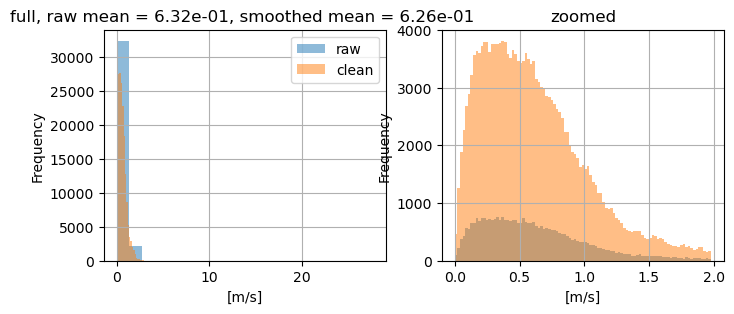

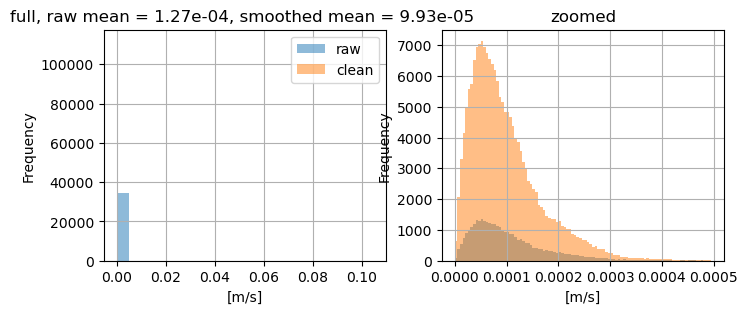

In [30]:
compare_histograms("velocity", "[m/s]", np.arange(0, 2, 0.02))
compare_histograms("acceleration", "[m/s]", np.arange(0, 5*1e-4, 5e-6))

## Other potentially useful plots


### overview map of the trajectories

/Users/aponte/.miniconda3/envs/pynsitu/lib/python3.10/site-packages/xarray/backends/plugins.py:139: RuntimeWarning: 'netcdf4' fails while guessing
  warnings.warn(f"{engine!r} fails while guessing", RuntimeWarning)
/Users/aponte/.miniconda3/envs/pynsitu/lib/python3.10/site-packages/xarray/backends/plugins.py:139: RuntimeWarning: 'scipy' fails while guessing
  warnings.warn(f"{engine!r} fails while guessing", RuntimeWarning)
/Users/aponte/.miniconda3/envs/pynsitu/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1614: UserWarning: The following kwargs were not used by contour: 'lw'
  result = super().contour(*args, **kwargs)


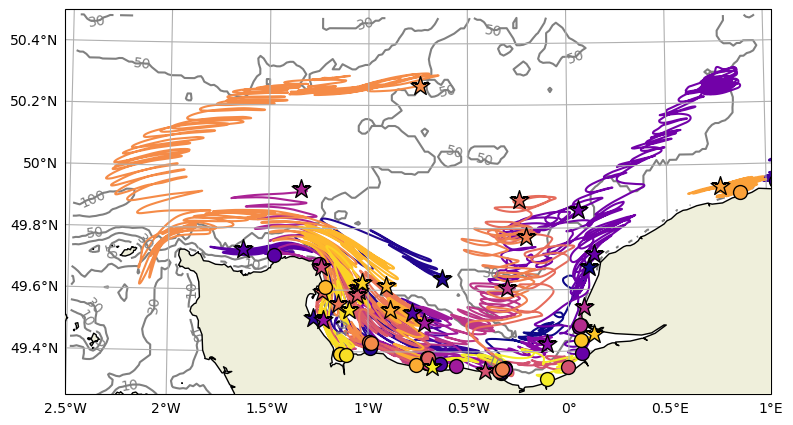

In [11]:
bounds=[-2.5, 1, 49.25, 50.5]

# plot map
fig, ax, cbar = cp.map(extent=bounds, rivers=False)

# add drifter tracks

_df = df_clean.reset_index().set_index(["platform", "deployment"])
keys = _df.groupby(_df.index).groups.keys()
colors = pin.get_cmap_colors(len(keys))

for k, c in zip(keys, colors):
    _dfk = _df.groupby(_df.index).get_group(k).reset_index().dropna(axis=1)
    ax.plot(_dfk.longitude, _dfk.latitude, color=c, transform=crs, label=", ".join(k))
    ax.scatter(_dfk.longitude.iloc[0], _dfk.latitude.iloc[0], color=c, transform=crs,
            edgecolor="k", s=100, zorder=10, marker="o",
           )
    ax.scatter(_dfk.longitude.iloc[-1], _dfk.latitude.iloc[-1], color=c, transform=crs,
            edgecolor="k", s=200, zorder=10, marker="*",
           )

#ax.legend()